<a href="https://colab.research.google.com/github/nguyen1oc/CROWD_COUNTING/blob/main/CROWD_COUNTING_USING_YOLOv11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#IMPORT


In [50]:
import os
import requests
import zipfile
import requests
from google.colab import drive
import numpy as np
from scipy.io import loadmat #dung de doc file .mat
import cv2
import scipy.io
from PIL import Image
import random
import shutil
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.neighbors import NearestNeighbors
import torch
import pandas as pd

In [ ]:
!find /content -mindepth 1 -maxdepth 1 -exec rm -rf {} + #Xóa các thư mục

#DOWNLOAD DATASET


In [ ]:
download_path = "/content/drive/MyDrive/ShanghaiTech_Download"
extract_path = "/content/drive/MyDrive/ShanghaiTech"

# Tạo thư mục lưu file và giải nén nếu chưa tồn tại
print("Kiểm tra và tạo thư mục...")
os.makedirs(download_path, exist_ok=True)
os.makedirs(extract_path, exist_ok=True)

# Link tải dataset từ Dropbox (lấy từ Papers with Code)
url = "https://www.dropbox.com/scl/fi/dkj5kulc9zj0rzesslck8/ShanghaiTech_Crowd_Counting_Dataset.zip?rlkey=ymbcj50ac04uvqn8p49j9af5f&dl=1"

# Đường dẫn để lưu file tải về
file_path = os.path.join(download_path, "ShanghaiTech_Crowd_Counting_Dataset.zip")

# Tải file từ Dropbox
print(f"Đang tải dataset từ {url}...")
response = requests.get(url, stream=True)
if response.status_code == 200:
    with open(file_path, 'wb') as f:
        for chunk in response.iter_content(chunk_size=8192):
            if chunk:
                f.write(chunk)
    print(f"Dataset đã được tải về tại {file_path}")
else:
    print(f"Lỗi khi tải file: HTTP Status Code {response.status_code}")
    print("Vui lòng kiểm tra lại link hoặc thử link Baidu Cloud Disk: https://pan.baidu.com/s/1xJnhmJbwPdnNKBM1K6F1Cg?pwd=iga3 (mật khẩu: iga3)")

# Giải nén file
if os.path.exists(file_path):
    print(f"Đang giải nén {file_path}...")
    with zipfile.ZipFile(file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print(f"Dataset đã được giải nén tại {extract_path}")
else:
    print("File không tồn tại để giải nén. Vui lòng kiểm tra lại bước tải.")

# Kiểm tra nội dung thư mục giải nén
part_a_path = os.path.join(extract_path, "part_A_final")
if os.path.exists(part_a_path):
    print("Nội dung thư mục part_A_final:")
    !ls "/content/drive/MyDrive/ShanghaiTech/part_A_final"
else:
    print("Thư mục part_A_final không tồn tại. Vui lòng kiểm tra lại quá trình giải nén.")

Kiểm tra và tạo thư mục...
Đang tải dataset từ https://www.dropbox.com/scl/fi/dkj5kulc9zj0rzesslck8/ShanghaiTech_Crowd_Counting_Dataset.zip?rlkey=ymbcj50ac04uvqn8p49j9af5f&dl=1...
Dataset đã được tải về tại /content/drive/MyDrive/ShanghaiTech_Download/ShanghaiTech_Crowd_Counting_Dataset.zip
Đang giải nén /content/drive/MyDrive/ShanghaiTech_Download/ShanghaiTech_Crowd_Counting_Dataset.zip...
Dataset đã được giải nén tại /content/drive/MyDrive/ShanghaiTech
Nội dung thư mục part_A_final:
test_data  train_data


#PREPROCESSING

In [ ]:
# Đọc file ground truth
mat = scipy.io.loadmat('/content/drive/MyDrive/ShanghaiTech/part_A_final/train_data/ground_truth/GT_IMG_1.mat')
points = mat["image_info"][0][0][0][0][0]  # lấy list điểm (tọa độ x, y)

# In thử 5 điểm đầu
for p in points[:5]:
    print(p)


[ 29.6225116  472.92022152]
[ 54.35533603 454.96602305]
[ 51.79045053 460.46220626]
[ 51.79045053 465.77518336]
[ 50.87442    473.65304595]


In [23]:
dataset_part = "/content/drive/MyDrive/ShanghaiTech/part_A_final"
output_path = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset"

# Đường dẫn tới ảnh và ground-truth
img_dir_train = os.path.join(dataset_part, "train_data", "images")
gt_dir_train = os.path.join(dataset_part, "train_data", "ground_truth")

img_dir_test = os.path.join(dataset_part, "test_data", "images")
gt_dir_test = os.path.join(dataset_part, "test_data", "ground_truth")

# Hàm tính khoảng cách trung bình giữa các điểm gần nhất
def estimate_head_size(points, k=3):
    if len(points) < 2:
        return 20  # Giá trị mặc định nếu không đủ điểm để tính

    # Sử dụng NearestNeighbors để tìm khoảng cách đến k điểm gần nhất
    nbrs = NearestNeighbors(n_neighbors=min(k, len(points)), algorithm='auto').fit(points)
    distances, _ = nbrs.kneighbors(points)

    # Lấy khoảng cách trung bình đến k điểm gần nhất (bỏ khoảng cách đến chính nó)
    avg_distances = np.mean(distances[:, 1:], axis=1)
    avg_head_size = np.mean(avg_distances)  # Trung bình toàn bộ ảnh

    return max(15, min(50, avg_head_size))  # Giới hạn box_size trong khoảng [15, 50]

# Hàm chuyển đổi annotation từ .mat sang YOLO với box_size động
def convert_mat_to_yolo(img_dir, gt_dir, output_img_dir, output_lbl_dir, k_neighbors=3):
    os.makedirs(output_img_dir, exist_ok=True)
    os.makedirs(output_lbl_dir, exist_ok=True)

    for img_name in os.listdir(img_dir):
        if not img_name.endswith('.jpg'):
            continue

        img_path = os.path.join(img_dir, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Không thể đọc ảnh {img_path}")
            continue

        h, w = img.shape[:2]
        gt_path = os.path.join(gt_dir, f"GT_{img_name.replace('.jpg', '.mat')}")
        if not os.path.exists(gt_path):
            print(f"Không tìm thấy ground-truth {gt_path}")
            continue

        mat = loadmat(gt_path)
        points = mat['image_info'][0, 0][0, 0][0]

        # Ước lượng kích thước đầu người dựa trên khoảng cách giữa các điểm
        box_size = estimate_head_size(points, k=k_neighbors)
        print(f"Image {img_name}: Estimated box_size = {box_size}")

        # Ghi file label
        label_path = os.path.join(output_lbl_dir, img_name.replace('.jpg', '.txt'))
        seen_points = set()
        with open(label_path, 'w') as f:
            for point in points:
                x, y = point
                # Chuẩn hóa tọa độ
                x_center = x / w
                y_center = y / h
                # Giới hạn tọa độ trong khoảng [0, 1]
                x_center = max(0, min(1, x_center))
                y_center = max(0, min(1, y_center))
                box_w = box_h = box_size / w  # square box
                # Đảm bảo box_w, box_h không âm
                box_w = max(0, min(1, box_w))
                box_h = max(0, min(1, box_h))

                # Kiểm tra nhãn trùng lặp
                label_tuple = (x_center, y_center)
                if label_tuple in seen_points:
                    print(f"Duplicate label in {img_name}: {x_center}, {y_center}")
                    continue
                seen_points.add(label_tuple)

                f.write(f"0 {x_center:.6f} {y_center:.6f} {box_w:.6f} {box_h:.6f}\n")

        output_img_path = os.path.join(output_img_dir, img_name)
        cv2.imwrite(output_img_path, img)


In [24]:
# Chuyển đổi dữ liệu train
convert_mat_to_yolo(
    img_dir_train,
    gt_dir_train,
    os.path.join(output_path, "images", "train"),
    os.path.join(output_path, "labels", "train"),
    k_neighbors=3
)

# Chuyển đổi dữ liệu test
convert_mat_to_yolo(
    img_dir_test,
    gt_dir_test,
    os.path.join(output_path, "images", "test"),
    os.path.join(output_path, "labels", "test"),
    k_neighbors=3
)

Image IMG_263.jpg: Estimated box_size = 15
Image IMG_57.jpg: Estimated box_size = 21.2365279624576
Image IMG_257.jpg: Estimated box_size = 16.405673299584322
Image IMG_22.jpg: Estimated box_size = 21.416186780831556
Image IMG_122.jpg: Estimated box_size = 16.902399823360792
Image IMG_269.jpg: Estimated box_size = 18.19675976182703
Image IMG_141.jpg: Estimated box_size = 50
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 1, 1
Duplicate label in IMG_141.jpg: 

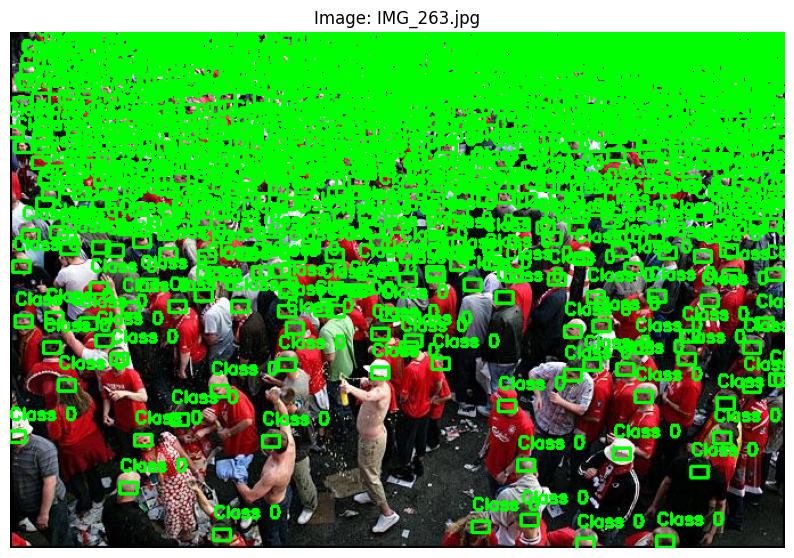

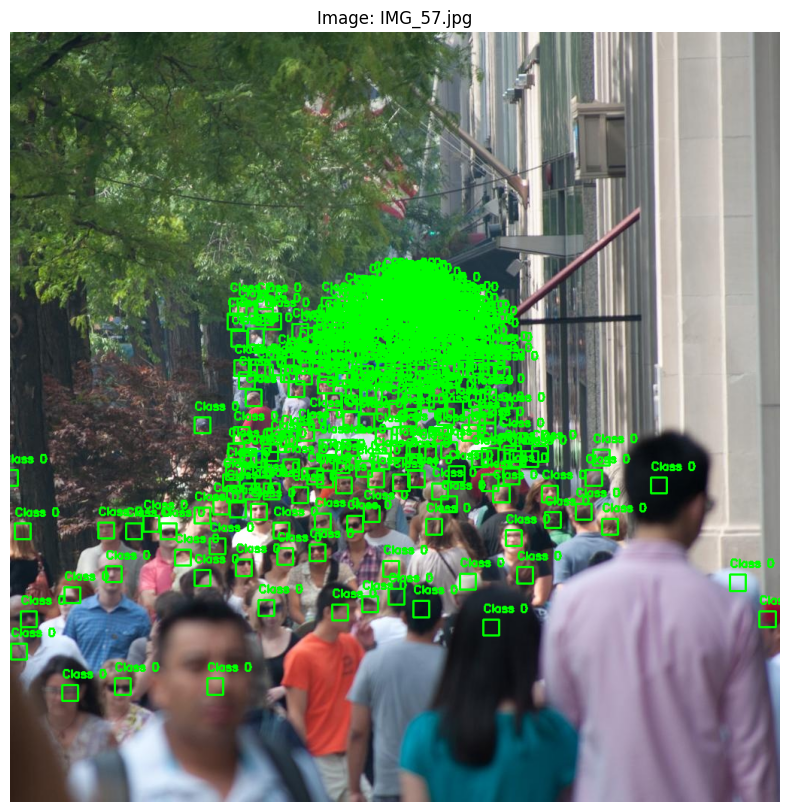

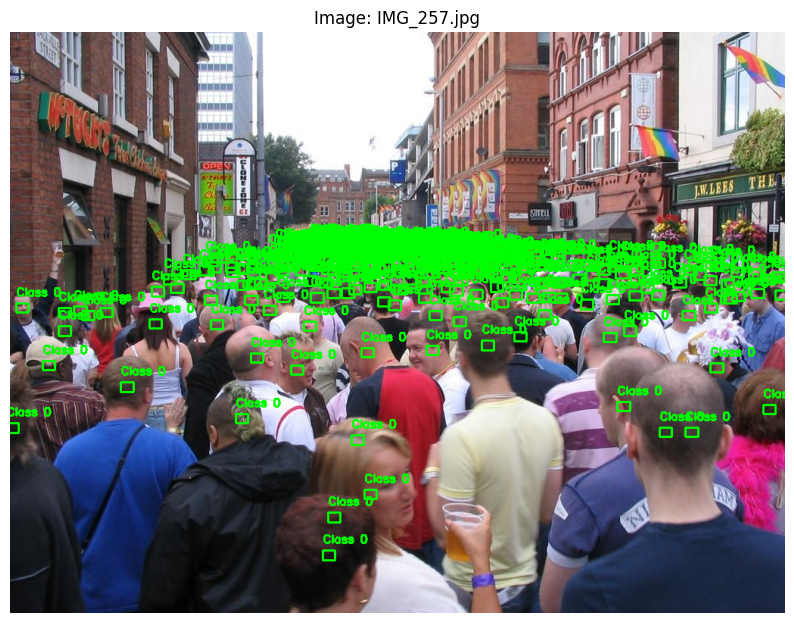

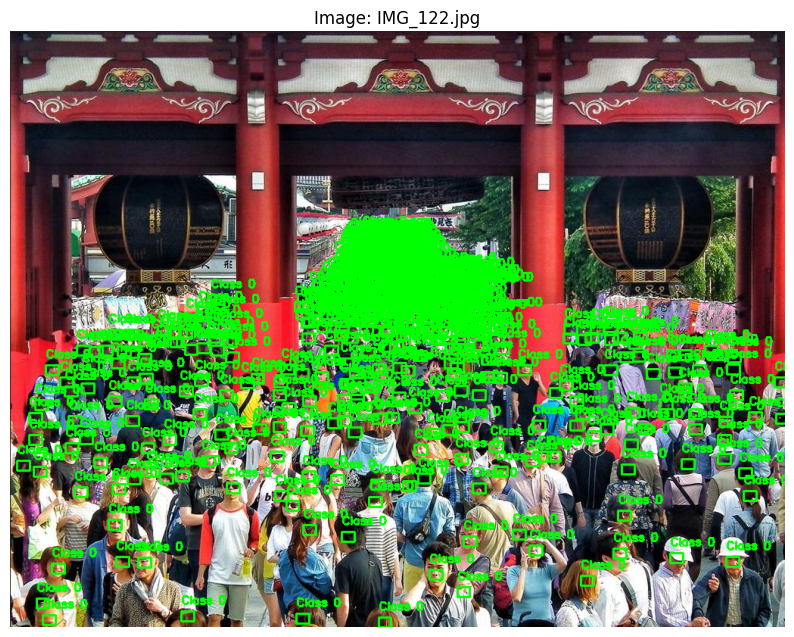

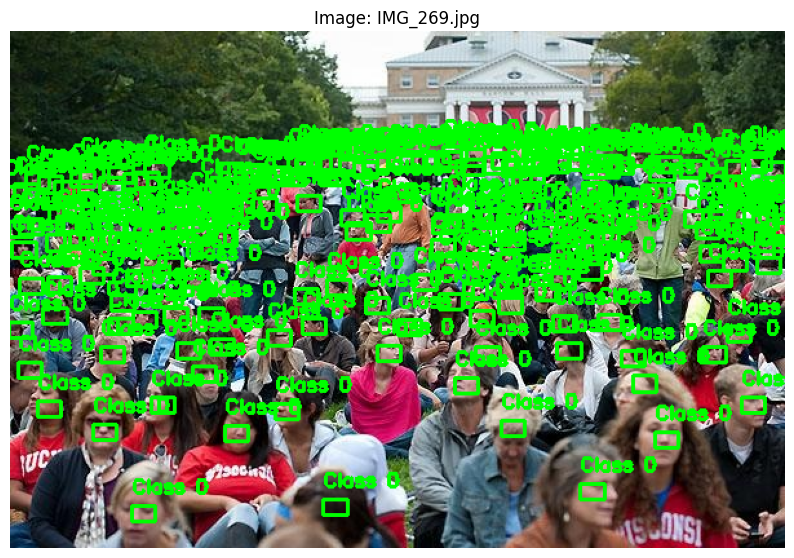

In [28]:
output_img_dir = os.path.join(output_path, "images", "train")
output_lbl_dir = os.path.join(output_path, "labels", "train")

# Hàm visualize hình ảnh với bounding box
def visualize_yolo_labels(img_dir, lbl_dir, num_images=5):
    img_files = [f for f in os.listdir(img_dir) if f.endswith('.jpg')]

    for img_name in img_files[:num_images]:
        # Đọc ảnh
        img_path = os.path.join(img_dir, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Không thể đọc ảnh {img_path}")
            continue

        h, w = img.shape[:2]

        # Đọc file nhãn
        label_path = os.path.join(lbl_dir, img_name.replace('.jpg', '.txt'))
        if not os.path.exists(label_path):
            print(f"Không tìm thấy nhãn {label_path}")
            continue

        # Đọc các bounding box từ file nhãn
        with open(label_path, 'r') as f:
            labels = f.readlines()

        # Vẽ bounding box lên ảnh
        for label in labels:
            class_id, x_center, y_center, box_w, box_h = map(float, label.strip().split())

            # Chuyển đổi tọa độ từ dạng chuẩn hóa về pixel
            x_center = x_center * w
            y_center = y_center * h
            box_w = box_w * w
            box_h = box_h * h

            x1 = int(x_center - box_w / 2)
            y1 = int(y_center - box_h / 2)
            x2 = int(x_center + box_w / 2)
            y2 = int(y_center + box_h / 2)

            # Vẽ bounding box lên ảnh
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img, f"head {conf:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Chuyển đổi màu từ BGR (OpenCV) sang RGB (Matplotlib)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Hiển thị ảnh
        plt.figure(figsize=(10, 10))
        plt.imshow(img_rgb)
        plt.title(f"Image: {img_name}")
        plt.axis('off')
        plt.show()

# Gọi hàm để visualize 5 ảnh đầu tiên
visualize_yolo_labels(output_img_dir, output_lbl_dir, num_images=5)

In [29]:
!cat /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train/IMG_282.txt

0 1.000000 0.409427 0.025055 0.025055
0 0.000000 0.344554 0.025055 0.025055
0 1.000000 0.249617 0.025055 0.025055
0 0.331794 0.659427 0.025055 0.025055
0 0.334167 0.615124 0.025055 0.025055
0 0.342474 0.578731 0.025055 0.025055
0 0.367395 0.586643 0.025055 0.025055
0 0.385196 0.559744 0.025055 0.025055
0 0.387569 0.630946 0.025055 0.025055
0 0.431477 0.583478 0.025055 0.025055
0 0.430291 0.567655 0.025055 0.025055
0 0.475385 0.556579 0.025055 0.025055
0 0.457585 0.531263 0.025055 0.025055
0 0.496746 0.534427 0.025055 0.025055
0 0.516920 0.556579 0.025055 0.025055
0 0.499120 0.558162 0.025055 0.025055
0 0.506240 0.605630 0.025055 0.025055
0 0.496746 0.634111 0.025055 0.025055
0 0.493186 0.670503 0.025055 0.025055
0 0.056477 0.874617 0.025055 0.025055
0 0.048170 0.955314 0.025055 0.025055
0 0.022063 0.806579 0.025055 0.025055
0 0.093265 0.784427 0.025055 0.025055
0 0.016129 0.705314 0.025055 0.025055
0 0.009009 0.634111 0.025055 0.025055
0 0.009009 0.548668 0.025055 0.025055
0 0.027996 0

In [30]:
base_path = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset"
train_img_dir = os.path.join(base_path, "images","train")
train_lbl_dir = os.path.join(base_path, "labels","train")

val_img_dir = os.path.join(base_path, "images","valid")
val_lbl_dir = os.path.join(base_path, "labels","valid")

# Tạo thư mục valid
os.makedirs(val_img_dir, exist_ok=True)
os.makedirs(val_lbl_dir, exist_ok=True)

# Danh sách ảnh trong train
image_files = [f for f in os.listdir(train_img_dir) if f.endswith('.jpg')]
random.seed(42)
val_size = int(0.2 * len(image_files))  # 20%
val_files = random.sample(image_files, val_size)

# Di chuyển ảnh và label
for img_name in val_files:
    label_name = img_name.replace('.jpg', '.txt')

    # Di chuyển ảnh
    shutil.move(os.path.join(train_img_dir, img_name), os.path.join(val_img_dir, img_name))

    # Di chuyển nhãn (nếu có)
    src_label = os.path.join(train_lbl_dir, label_name)
    if os.path.exists(src_label):
        shutil.move(src_label, os.path.join(val_lbl_dir, label_name))

print(f"Đã chuyển {val_size} ảnh + label từ train_data sang valid_data.")

✅ Đã chuyển 48 ảnh + label từ train_data sang valid_data.


In [31]:
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/train | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/valid | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/valid | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test | wc -l
!ls -l /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/test | wc -l

193
193
109
109
183
183


#TRAIN AND VALID


In [32]:
!pip install ultralytics

In [33]:
import ultralytics
print(ultralytics.__version__)

8.3.107


In [35]:
yaml_content = """
train: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/train
val: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/valid
test: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test

nc: 1
names: ['crack']
"""

with open("yolov11_dataset.yaml", "w") as f:
    f.write(yaml_content)


In [36]:
from ultralytics import YOLO
model = YOLO("yolo11n.pt")
results = model.train(data="yolov11_dataset.yaml",
                      epochs=10,
                      imgsz=640,
                      device = 0,
                      close_mosaic=1 ,
                      batch = 4,
                      augment = True,
                      stream_buffer = True,
                      cache = "disk",
                      dropout = 0.3,
                      iou = 0.7,
                      optimizer = 'AdamW',
                      lr0 = 0.001,
                      patience=20,
                      nms = True)

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=yolov11_dataset.yaml, epochs=10, time=None, patience=20, batch=4, imgsz=640, save=True, save_period=-1, cache=disk, device=0, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=1, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.3, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=True, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=

train: Scanning /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train... 192 images, 0 backgrounds, 0 corrupt: 100%|██████████| 192/192 [00:00<00:00, 610.16it/s]

train: WARNING ⚠️ /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/train/IMG_76.jpg: 1 duplicate labels removed
train: New cache created: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/train.cache



train: Caching images (0.3GB Disk): 100%|██████████| 192/192 [00:01<00:00, 136.37it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/valid... 108 images, 0 backgrounds, 0 corrupt: 100%|██████████| 108/108 [00:00<00:00, 277.94it/s]

val: New cache created: /content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/valid.cache



val: Caching images (0.2GB Disk): 100%|██████████| 108/108 [00:00<00:00, 108.08it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 10 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      8.61G      4.105      2.463      1.397       3418        640: 100%|██████████| 48/48 [00:12<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:05<00:00,  2.51it/s]

                   all        108      57786      0.182      0.102      0.107     0.0287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      7.29G      3.704      1.792      1.243       5396        640: 100%|██████████| 48/48 [00:10<00:00,  4.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.61it/s]


                   all        108      57786      0.175     0.0983      0.105     0.0289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10       7.3G      3.563      1.728      1.219       4007        640: 100%|██████████| 48/48 [00:11<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:04<00:00,  3.13it/s]


                   all        108      57786      0.224      0.126      0.136     0.0388

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      7.32G      3.593      1.715      1.207       2812        640: 100%|██████████| 48/48 [00:13<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.09it/s]


                   all        108      57786     0.0908     0.0509     0.0477     0.0139

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      7.33G      3.477       1.68      1.202        961        640: 100%|██████████| 48/48 [00:10<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:04<00:00,  3.46it/s]

                   all        108      57786      0.235      0.132      0.145      0.043



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      7.35G      3.466      1.622      1.158       3409        640: 100%|██████████| 48/48 [00:09<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.50it/s]


                   all        108      57786      0.275      0.154      0.174     0.0539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      10.3G      3.453      1.683       1.18       4807        640: 100%|██████████| 48/48 [00:09<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.70it/s]

                   all        108      57786      0.334      0.186      0.219     0.0675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      10.3G       3.42      1.645      1.179       3159        640: 100%|██████████| 48/48 [00:10<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.00it/s]


                   all        108      57786      0.334      0.186      0.219     0.0686

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      10.4G      3.425      1.613      1.159       2330        640: 100%|██████████| 48/48 [00:10<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.04it/s]


                   all        108      57786       0.29      0.162      0.191     0.0607
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      10.4G      3.478      1.902      1.227       1295        640: 100%|██████████| 48/48 [00:09<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.92it/s]


                   all        108      57786      0.284      0.157      0.189     0.0581

10 epochs completed in 0.044 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 5.5MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:24<00:00,  1.75s/it]


                   all        108      57786      0.312      0.174      0.201     0.0637
Speed: 0.3ms preprocess, 47.9ms inference, 0.0ms loss, 29.0ms postprocess per image
Results saved to runs/detect/train2


#INFERENCE

In [42]:
# Chạy inference với YOLOv11
!yolo predict model=runs/detect/train2/weights/best.pt source=/content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test imgsz=640 conf=0.25 save_txt=True save_conf=True

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs

image 1/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_1.jpg: 448x640 50 cracks, 46.6ms
image 2/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_10.jpg: 480x640 76 cracks, 44.2ms
image 3/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_100.jpg: 320x640 174 cracks, 56.4ms
image 4/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_101.jpg: 512x640 5 cracks, 41.6ms
image 5/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_102.jpg: 384x640 129 cracks, 41.4ms
image 6/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_103.jpg: 416x640 122 cracks, 41.5ms
image 7/182 /content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test/IMG_104.jpg: 448x640 138 cracks, 8.9ms
image 8/182 /content/drive/MyDrive/ShanghaiTech/yo

#VISUALIZE


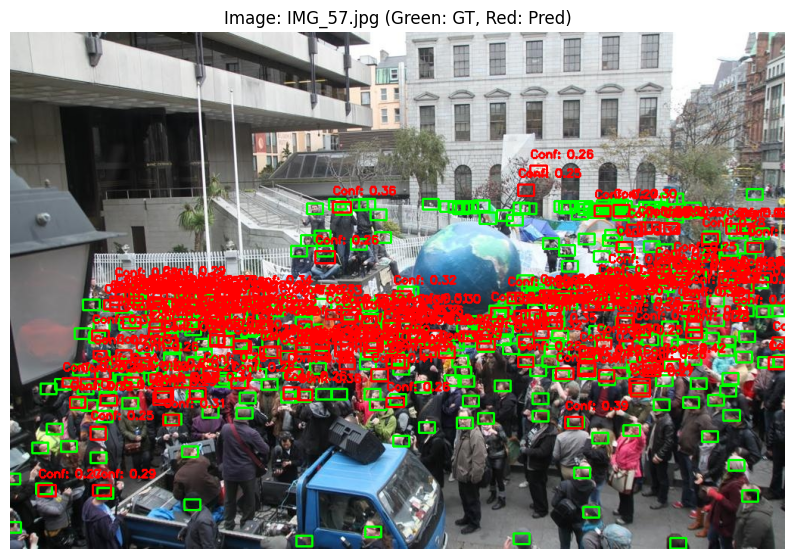

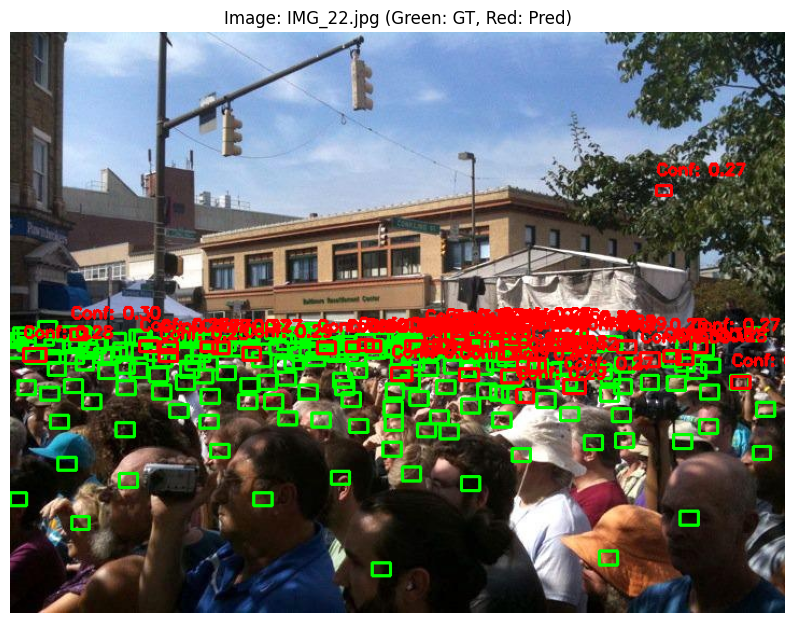

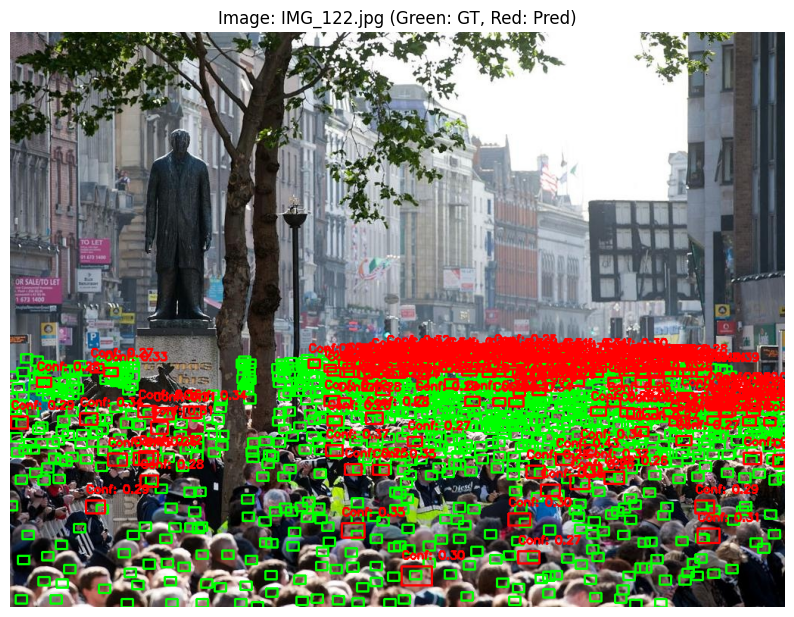

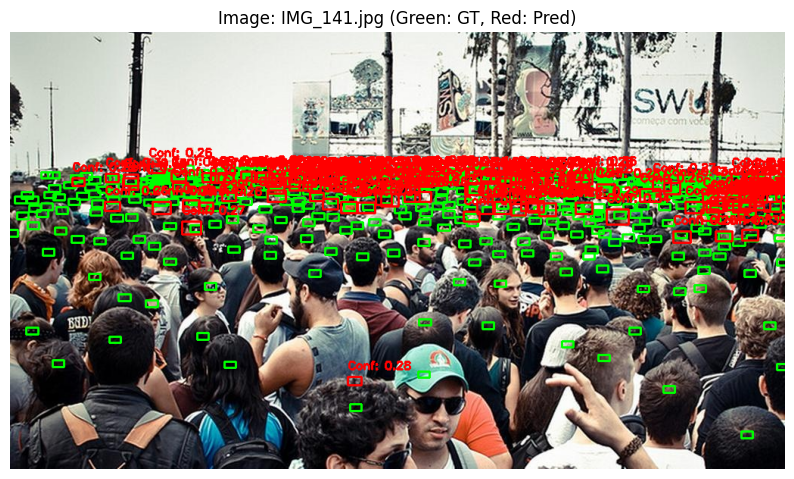

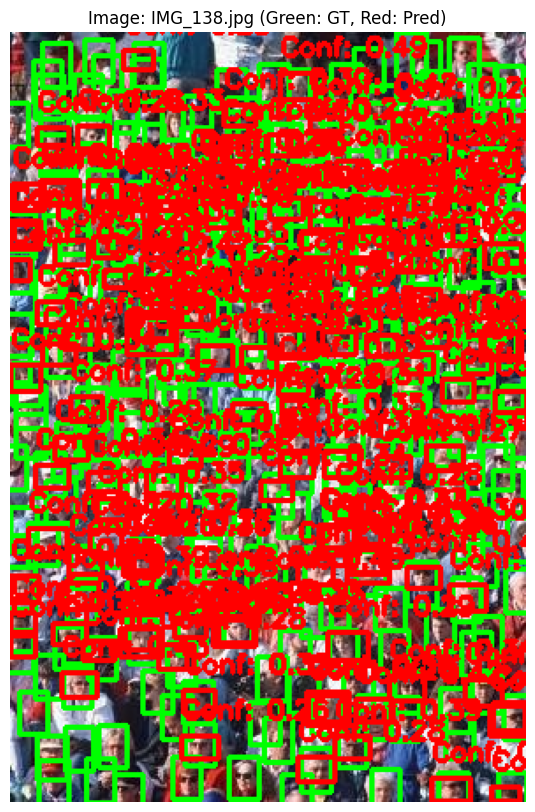

In [43]:
test_img_dir = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset/images/test"
test_lbl_dir = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/test"
pred_lbl_dir = "runs/detect/predict/labels"

# Hàm visualize ground-truth và dự đoán
def visualize_predictions(img_dir, gt_dir, pred_dir, num_images=5):
    img_files = [f for f in os.listdir(img_dir) if f.endswith('.jpg')]

    for img_name in img_files[:num_images]:
        # Đọc ảnh
        img_path = os.path.join(img_dir, img_name)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Không thể đọc ảnh {img_path}")
            continue

        h, w = img.shape[:2]

        # Đọc ground-truth
        gt_path = os.path.join(gt_dir, img_name.replace('.jpg', '.txt'))
        gt_boxes = []
        if os.path.exists(gt_path):
            with open(gt_path, 'r') as f:
                gt_boxes = f.readlines()

        # Đọc dự đoán
        pred_path = os.path.join(pred_dir, img_name.replace('.jpg', '.txt'))
        pred_boxes = []
        if os.path.exists(pred_path):
            with open(pred_path, 'r') as f:
                pred_boxes = f.readlines()

        # Vẽ ground-truth (màu xanh lá)
        for box in gt_boxes:
            class_id, x_center, y_center, box_w, box_h = map(float, box.strip().split())
            x_center, y_center, box_w, box_h = x_center * w, y_center * h, box_w * w, box_h * h
            x1, y1 = int(x_center - box_w / 2), int(y_center - box_h / 2)
            x2, y2 = int(x_center + box_w / 2), int(y_center + box_h / 2)
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Vẽ dự đoán (màu đỏ)
        for box in pred_boxes:
            class_id, x_center, y_center, box_w, box_h, conf = map(float, box.strip().split())
            x_center, y_center, box_w, box_h = x_center * w, y_center * h, box_w * w, box_h * h
            x1, y1 = int(x_center - box_w / 2), int(y_center - box_h / 2)
            x2, y2 = int(x_center + box_w / 2), int(y_center + box_h / 2)
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(img, f"Conf: {conf:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10, 10))
        plt.imshow(img_rgb)
        plt.title(f"Image: {img_name} (Green: GT, Red: Pred)")
        plt.axis('off')
        plt.show()

# Visualize 5 ảnh đầu tiên
visualize_predictions(test_img_dir, test_lbl_dir, pred_lbl_dir, num_images=5)

In [ ]:
model = YOLO('runs/train/train2/weights/best.pt')

# Muốn thêm ảnh mới thì để vô
img = cv2.imread('path/to/new/image.jpg')
results = model.predict(img, imgsz=640, conf=0.25)

results[0].show()
print(results[0].boxes.xyxy)

In [44]:
# Đếm số lượng đầu người từ file dự đoán
def count_heads(pred_dir):
    total_heads = 0
    for pred_file in os.listdir(pred_dir):
        if not pred_file.endswith('.txt'):
            continue
        pred_path = os.path.join(pred_dir, pred_file)
        with open(pred_path, 'r') as f:
            boxes = f.readlines()
        num_heads = len(boxes)
        print(f"Image {pred_file}: {num_heads} heads")
        total_heads += num_heads
    print(f"Total heads in test set: {total_heads}")

count_heads(pred_lbl_dir)

Image IMG_70.txt: 72 heads
Image IMG_97.txt: 300 heads
Image IMG_166.txt: 9 heads
Image IMG_30.txt: 150 heads
Image IMG_22.txt: 47 heads
Image IMG_81.txt: 149 heads
Image IMG_125.txt: 138 heads
Image IMG_25.txt: 38 heads
Image IMG_179.txt: 69 heads
Image IMG_133.txt: 11 heads
Image IMG_92.txt: 300 heads
Image IMG_108.txt: 48 heads
Image IMG_85.txt: 15 heads
Image IMG_156.txt: 56 heads
Image IMG_180.txt: 121 heads
Image IMG_117.txt: 300 heads
Image IMG_41.txt: 34 heads
Image IMG_167.txt: 46 heads
Image IMG_29.txt: 49 heads
Image IMG_141.txt: 120 heads
Image IMG_135.txt: 11 heads
Image IMG_49.txt: 120 heads
Image IMG_57.txt: 194 heads
Image IMG_99.txt: 3 heads
Image IMG_65.txt: 71 heads
Image IMG_98.txt: 14 heads
Image IMG_155.txt: 36 heads
Image IMG_67.txt: 103 heads
Image IMG_144.txt: 134 heads
Image IMG_174.txt: 24 heads
Image IMG_164.txt: 68 heads
Image IMG_88.txt: 27 heads
Image IMG_150.txt: 300 heads
Image IMG_40.txt: 53 heads
Image IMG_151.txt: 11 heads
Image IMG_61.txt: 9 heads
I

In [45]:
def count_heads_ground_truth(gt_dir):
    total_heads = 0
    for gt_file in os.listdir(gt_dir):
        if not gt_file.endswith('.txt'):
            continue
        gt_path = os.path.join(gt_dir, gt_file)
        with open(gt_path, 'r') as f:
            boxes = f.readlines()
        num_heads = len(boxes)
        print(f"Image {gt_file}: {num_heads} heads (Ground Truth)")
        total_heads += num_heads
    print(f"Total heads in test set (Ground Truth): {total_heads}")

test_lbl_dir = "/content/drive/MyDrive/ShanghaiTech/yolo_dataset/labels/test"
count_heads_ground_truth(test_lbl_dir)

# So sánh với dự đoán
count_heads(pred_lbl_dir)

Image IMG_70.txt: 412 heads (Ground Truth)
Image IMG_97.txt: 478 heads (Ground Truth)
Image IMG_166.txt: 126 heads (Ground Truth)
Image IMG_30.txt: 307 heads (Ground Truth)
Image IMG_22.txt: 212 heads (Ground Truth)
Image IMG_81.txt: 356 heads (Ground Truth)
Image IMG_125.txt: 269 heads (Ground Truth)
Image IMG_25.txt: 243 heads (Ground Truth)
Image IMG_179.txt: 400 heads (Ground Truth)
Image IMG_133.txt: 137 heads (Ground Truth)
Image IMG_92.txt: 1366 heads (Ground Truth)
Image IMG_108.txt: 181 heads (Ground Truth)
Image IMG_85.txt: 97 heads (Ground Truth)
Image IMG_156.txt: 199 heads (Ground Truth)
Image IMG_180.txt: 398 heads (Ground Truth)
Image IMG_117.txt: 1603 heads (Ground Truth)
Image IMG_41.txt: 250 heads (Ground Truth)
Image IMG_167.txt: 112 heads (Ground Truth)
Image IMG_29.txt: 309 heads (Ground Truth)
Image IMG_141.txt: 475 heads (Ground Truth)
Image IMG_135.txt: 72 heads (Ground Truth)
Image IMG_49.txt: 514 heads (Ground Truth)
Image IMG_57.txt: 356 heads (Ground Truth)


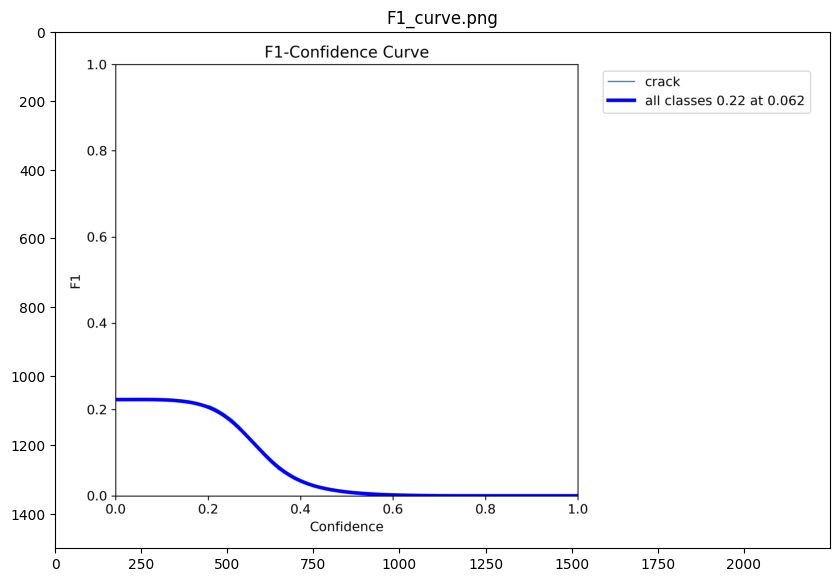

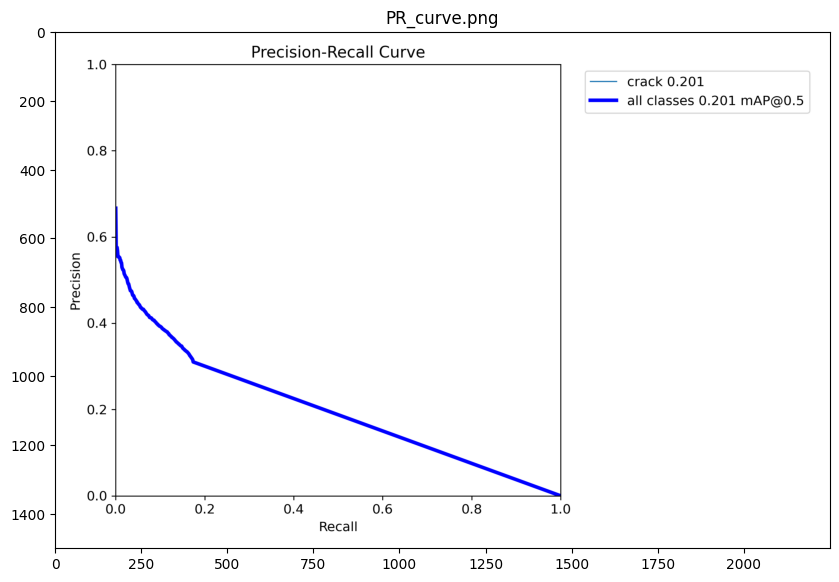

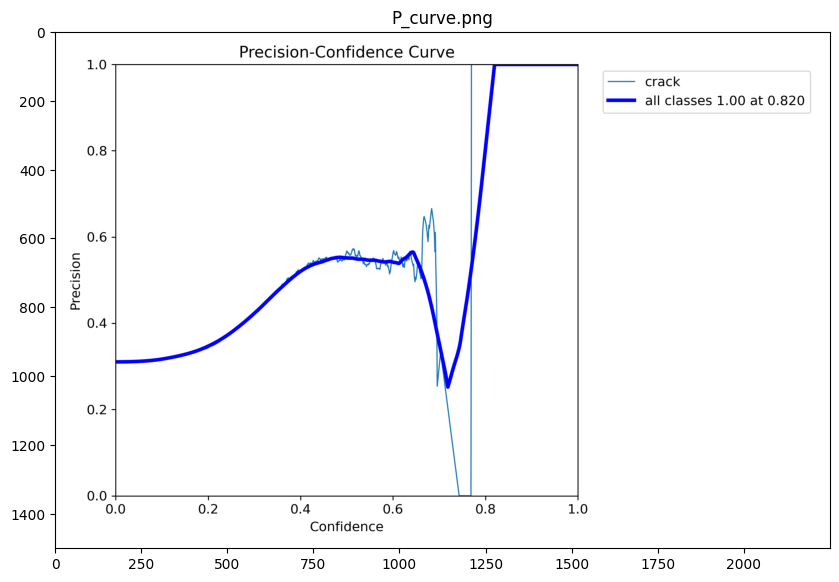

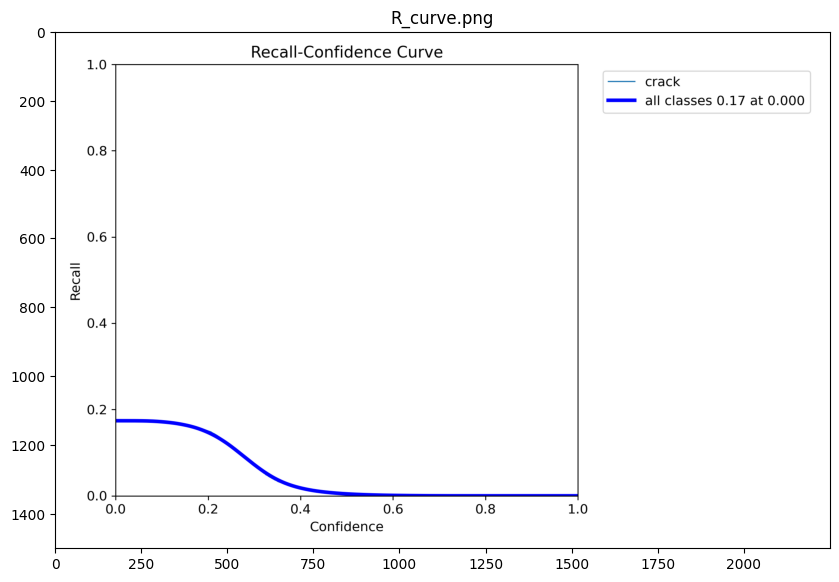

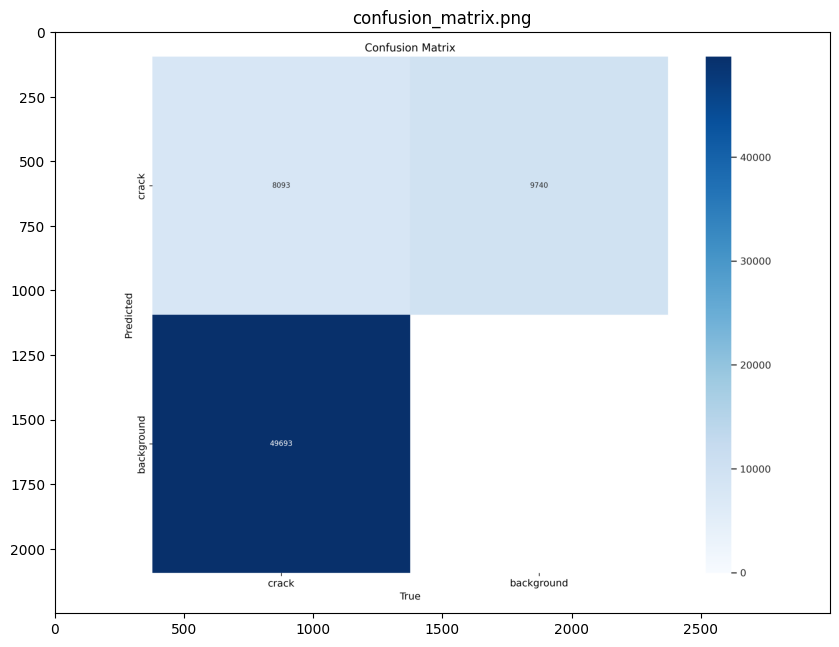

...

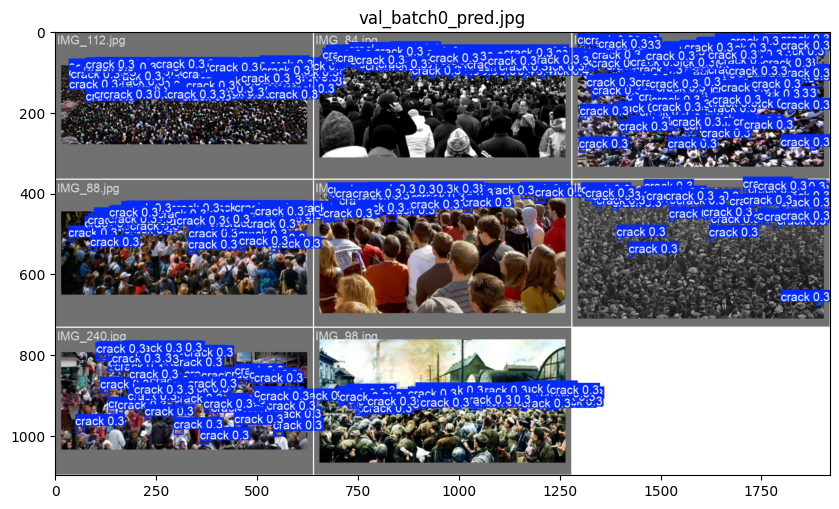

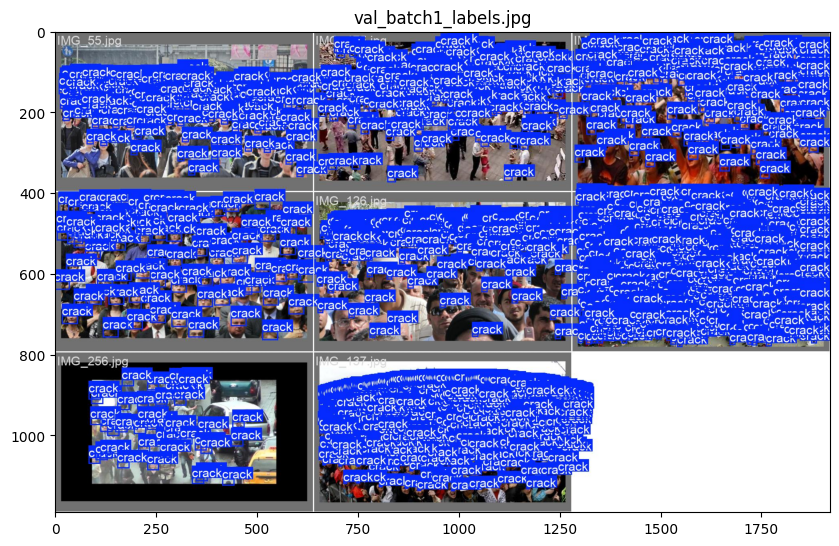

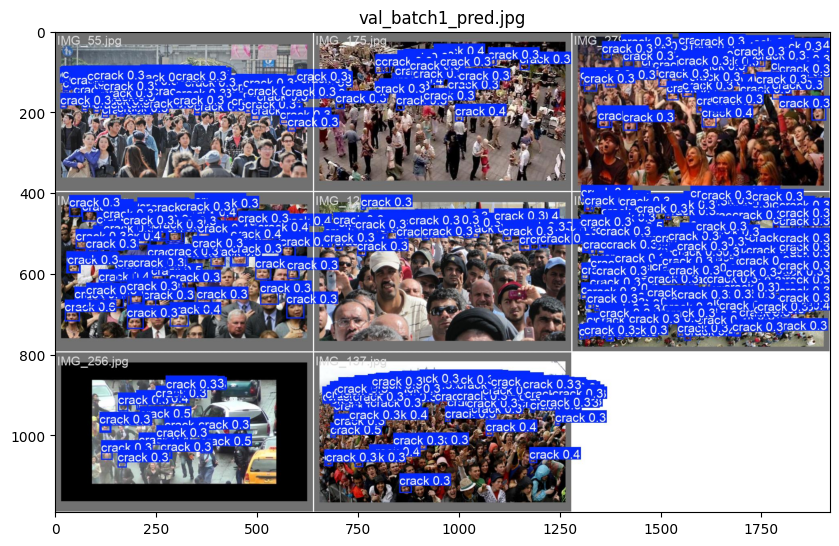

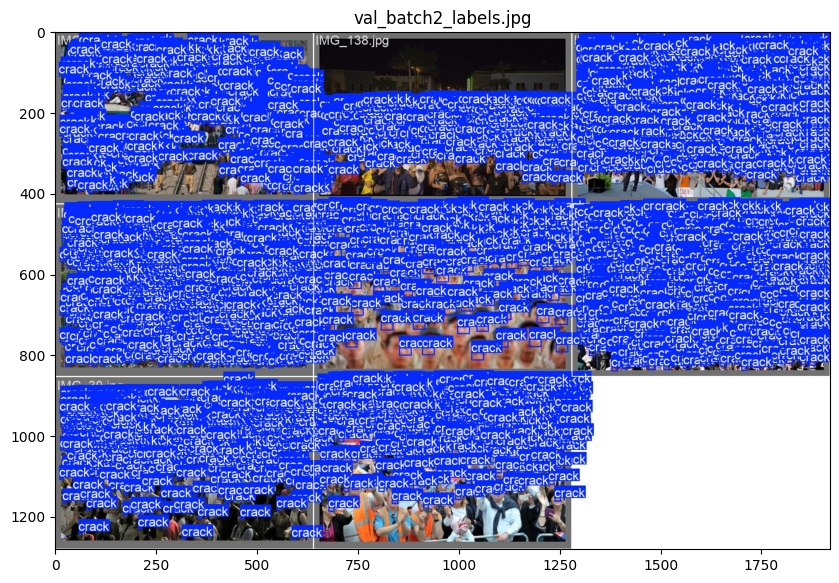

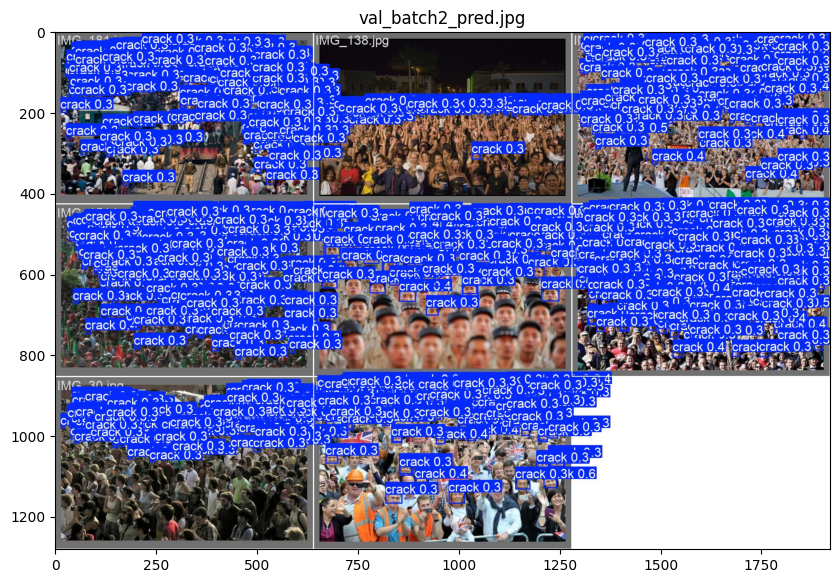

In [49]:
def display_images_from_folder(folder_path):
    image_extensions = ('.png', '.jpg', '.jpeg')
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(image_extensions)]

    image_files.sort()

    for image_file in image_files:
        image_path = os.path.join(folder_path, image_file)
        img = mpimg.imread(image_path)

        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(image_file)
        plt.axis('on')
        plt.show()

folder_path = "runs/detect/train2"

display_images_from_folder(folder_path)

In [53]:
results_df = pd.read_csv("runs/detect/train2/results.csv")
print(results_df)

   epoch      time  train/box_loss  train/cls_loss  train/dfl_loss  \
0      1   22.4656         4.10490         2.46307         1.39680   
1      2   38.1924         3.70358         1.79231         1.24278   
2      3   54.7326         3.56252         1.72765         1.21947   
3      4   71.7775         3.59286         1.71523         1.20703   
4      5   87.1587         3.47658         1.68041         1.20211   
5      6  101.1470         3.46558         1.62214         1.15764   
6      7  114.5240         3.45349         1.68255         1.17979   
7      8  128.4740         3.41988         1.64536         1.17939   
8      9  142.8520         3.42476         1.61262         1.15865   
9     10  156.8210         3.47776         1.90211         1.22653   

   metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0               0.18238            0.10226           0.10718   
1               0.17537            0.09833           0.10509   
2               0.22404            0.

In [58]:
def print_evaluation_metrics(train_dir):
    results_path = f"{train_dir}/results.csv"
    if not os.path.exists(results_path):
        print(f"File {results_path} không tồn tại. Vui lòng kiểm tra lại thư mục huấn luyện.")
        return
    results_df = pd.read_csv(results_path)
    results_df.columns = results_df.columns.str.strip()
    last_epoch = results_df.iloc[-1]
    print("=== Đánh giá mô hình (Epoch cuối cùng) ===")
    print(f"Precision: {last_epoch['metrics/precision(B)']:.4f}")
    print(f"Recall: {last_epoch['metrics/recall(B)']:.4f}")
    print(f"F1-score (ước lượng): {last_epoch['metrics/precision(B)'] * last_epoch['metrics/recall(B)'] * 2 / (last_epoch['metrics/precision(B)'] + last_epoch['metrics/recall(B)']):.4f}")
    print(f"mAP@50: {last_epoch['metrics/mAP50(B)']:.4f}")
    print(f"mAP@50:95: {last_epoch['metrics/mAP50-95(B)']:.4f}")

    print("\n=== Loss (Epoch cuối cùng) ===")
    print(f"Train Box Loss: {last_epoch['train/box_loss']:.4f}")
    print(f"Train Class Loss: {last_epoch['train/cls_loss']:.4f}")
    print(f"Train DFL Loss: {last_epoch['train/dfl_loss']:.4f}")
    print(f"Validation Box Loss: {last_epoch['val/box_loss']:.4f}")
    print(f"Validation Class Loss: {last_epoch['val/cls_loss']:.4f}")
    print(f"Validation DFL Loss: {last_epoch['val/dfl_loss']:.4f}")

train_dir = "runs/detect/train2"
print_evaluation_metrics(train_dir)

=== Đánh giá mô hình (Epoch cuối cùng) ===
Precision: 0.2836
Recall: 0.1569
F1-score (ước lượng): 0.2020
mAP@50: 0.1886
mAP@50:95: 0.0580

=== Loss (Epoch cuối cùng) ===
Train Box Loss: 3.4778
Train Class Loss: 1.9021
Train DFL Loss: 1.2265
Validation Box Loss: 3.3647
Validation Class Loss: 1.6027
Validation DFL Loss: 1.1755
